In [4]:
# Natural Language Processing NLP

In [5]:
## resnet visualize

In [25]:
import torchvision
import torch.nn.functional as F
from torchvision.transforms import transforms
from torch import nn
import torch
import matplotlib.pyplot as plt
from icecream import ic
from PIL import Image
import numpy as np

In [26]:
def visualize_model(model, input_, output):
    width = 8
    fig, ax = plt.subplots(output[0].shape[0] // width, width, figsize=(20, 20))

    for i in range(output[0].shape[0]):
        ix = np.unravel_index(i, ax.shape)
        plt.sca(ax[ix])
        ax[ix].title.set_text('filter-{}'.format(i))
        plt.imshow(output[0][i].detach())

    plt.show()

In [27]:
preprocess = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
])

In [28]:
resnet = torchvision.models.resnet18(pretrained=True) # transfer step 1: load pretrained model

conv_model = [m for _, m in resnet.named_modules() if isinstance(m, torch.nn.Conv2d)]

In [29]:
for m in conv_model:
    m.register_forward_hook(visualize_model)

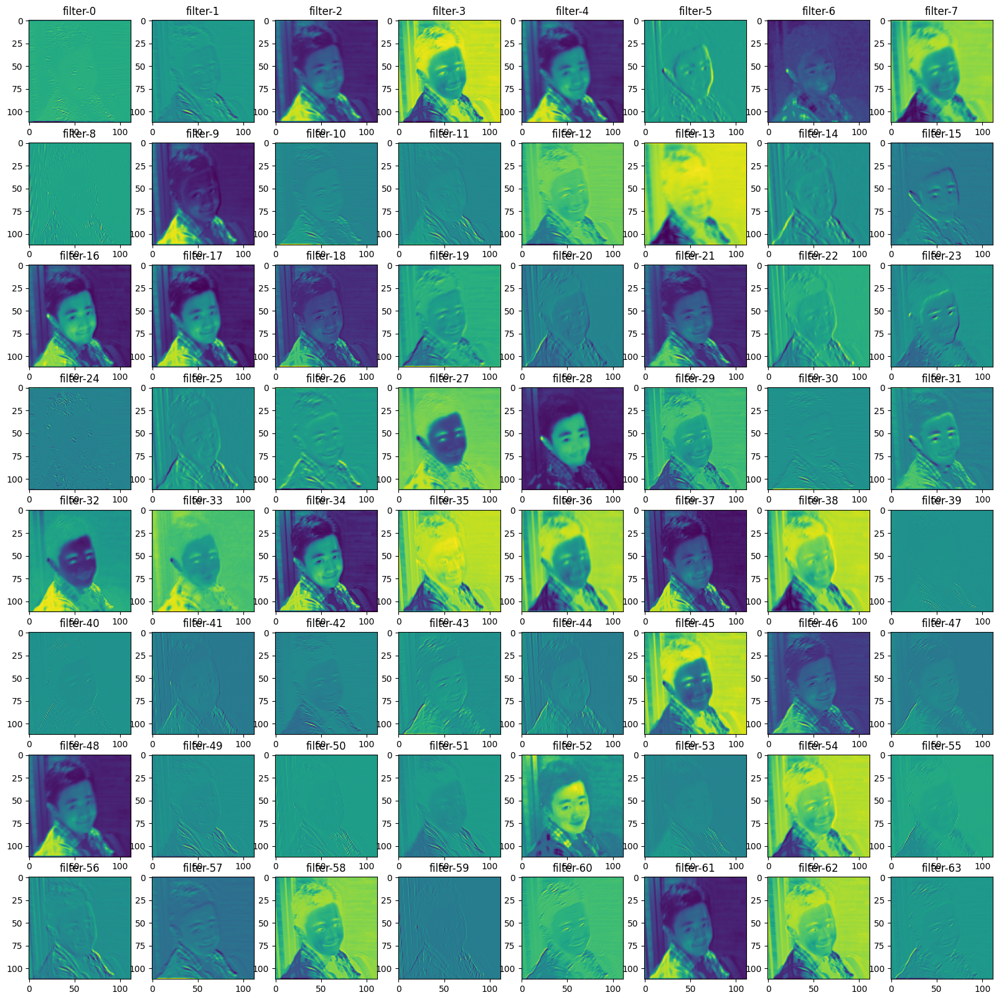

KeyboardInterrupt: 

In [30]:
myself = preprocess(Image.open('../../resource/course_data/doo.jpeg'))

with torch.no_grad():
    resnet(myself.unsqueeze(0)) # un-squeeze for convert myself to [ [myself] ]

## transfer example

In [1]:
import torchvision
import torch.nn.functional as F
from torchvision.transforms import transforms
from torch import nn
import torch
import matplotlib.pyplot as plt
from icecream import ic

In [2]:
preprocess = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
])

In [5]:
cifar_10 = torchvision.datasets.CIFAR10('../../resource/course_data/', download=False, transform=preprocess)

train_loader = torch.utils.data.DataLoader(cifar_10, batch_size=128, shuffle=True)

resnet = torchvision.models.resnet18(pretrained=True) # transfer step 1: load pretrained model

Files already downloaded and verified


In [6]:
for param in resnet.parameters():
    param.requires_grad = False  # frozen weights

In [7]:
feature_num = resnet.fc.in_features
resnet.fc = nn.Linear(feature_num, 10)  # rewrite fc classifier

ic(resnet(cifar_10[0][0].unsqueeze(0)))

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(resnet.parameters(), lr=1e-3, momentum=0.9)

epochs = 2

losses = []

/Users/lilithgames/opt/anaconda3/envs/tensorflow/lib/python3.7/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  ../c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
ic| resnet(cifar_10[0][0].unsqueeze(0)): tensor([[-0.0763, -0.4537,  0.8168,  0.2136, -0.0465,  0.4844, -0.4026,  0.8763,
                                                  -0.7048, -0.7375]], grad_fn=<AddmmBackward>)


In [8]:
for epoch in range(epochs):
    epoch_loss = 0
    for i, (images, labels) in enumerate(train_loader):
        ic(epoch, i)
        output = resnet(images)
        loss = criterion(output, labels)
        optimizer.zero_grad()

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()

        if i > 0:
            print('Epoch: {} batch:{}, loss ==> {}'.format(epoch, i, epoch_loss / i))

    losses.append(epoch_loss / i)



ic| epoch: 0, i: 0
ic| epoch: 0, i: 1
ic| epoch: 0, i: 2


Epoch: 0 batch:1, loss ==> 5.118020296096802


ic| epoch: 0, i: 3


Epoch: 0 batch:2, loss ==> 3.8235710859298706


ic| epoch: 0, i: 4


Epoch: 0 batch:3, loss ==> 3.3660876750946045


ic| epoch: 0, i: 5


Epoch: 0 batch:4, loss ==> 3.122998535633087


ic| epoch: 0, i: 6


Epoch: 0 batch:5, loss ==> 2.9719083309173584
Epoch: 0 batch:6, loss ==> 2.8621468941370645


ic| epoch: 0, i: 7
ic| epoch: 0, i: 8


Epoch: 0 batch:7, loss ==> 2.789283718381609


ic| epoch: 0, i: 9


Epoch: 0 batch:8, loss ==> 2.7358585000038147


ic| epoch: 0, i: 10


Epoch: 0 batch:9, loss ==> 2.6845270792643228


ic| epoch: 0, i: 11


Epoch: 0 batch:10, loss ==> 2.6438777923583983


ic| epoch: 0, i: 12


Epoch: 0 batch:11, loss ==> 2.6138229586861352


ic| epoch: 0, i: 13


Epoch: 0 batch:12, loss ==> 2.5836610794067383


ic| epoch: 0, i: 14


Epoch: 0 batch:13, loss ==> 2.5553486347198486


ic| epoch: 0, i: 15


Epoch: 0 batch:14, loss ==> 2.537844794137137


ic| epoch: 0, i: 16


Epoch: 0 batch:15, loss ==> 2.523111581802368


ic| epoch: 0, i: 17


Epoch: 0 batch:16, loss ==> 2.5051268190145493


ic| epoch: 0, i: 18


Epoch: 0 batch:17, loss ==> 2.491418445811552


ic| epoch: 0, i: 19


Epoch: 0 batch:18, loss ==> 2.4734070565965443


ic| epoch: 0, i: 20


Epoch: 0 batch:19, loss ==> 2.458929337953266


ic| epoch: 0, i: 21


Epoch: 0 batch:20, loss ==> 2.4454291462898254


ic| epoch: 0, i: 22


Epoch: 0 batch:21, loss ==> 2.432853562491281


ic| epoch: 0, i: 23


Epoch: 0 batch:22, loss ==> 2.4157026572660967


ic| epoch: 0, i: 24


Epoch: 0 batch:23, loss ==> 2.3991116648134976


ic| epoch: 0, i: 25


Epoch: 0 batch:24, loss ==> 2.384296198685964


ic| epoch: 0, i: 26


Epoch: 0 batch:25, loss ==> 2.3712824249267577


ic| epoch: 0, i: 27


Epoch: 0 batch:26, loss ==> 2.3561046857100267


ic| epoch: 0, i: 28


Epoch: 0 batch:27, loss ==> 2.343917890831276


ic| epoch: 0, i: 29


Epoch: 0 batch:28, loss ==> 2.331889348370688


ic| epoch: 0, i: 30


Epoch: 0 batch:29, loss ==> 2.3210734416698586


ic| epoch: 0, i: 31


Epoch: 0 batch:30, loss ==> 2.307398092746735


ic| epoch: 0, i: 32


Epoch: 0 batch:31, loss ==> 2.295638642003459


ic| epoch: 0, i: 33


Epoch: 0 batch:32, loss ==> 2.2832741402089596


ic| epoch: 0, i: 34


Epoch: 0 batch:33, loss ==> 2.27205322005532


ic| epoch: 0, i: 35


Epoch: 0 batch:34, loss ==> 2.2636543056544136


ic| epoch: 0, i: 36


Epoch: 0 batch:35, loss ==> 2.254075506755284


ic| epoch: 0, i: 37


Epoch: 0 batch:36, loss ==> 2.2437352438767753


ic| epoch: 0, i: 38


Epoch: 0 batch:37, loss ==> 2.2320169983683407


ic| epoch: 0, i: 39


Epoch: 0 batch:38, loss ==> 2.2213603822808516


ic| epoch: 0, i: 40


Epoch: 0 batch:39, loss ==> 2.212883078134977


ic| epoch: 0, i: 41


Epoch: 0 batch:40, loss ==> 2.2030535876750945


ic| epoch: 0, i: 42


Epoch: 0 batch:41, loss ==> 2.192888739632397


ic| epoch: 0, i: 43


Epoch: 0 batch:42, loss ==> 2.1840779128528776


ic| epoch: 0, i: 44


Epoch: 0 batch:43, loss ==> 2.1747339243112607


ic| epoch: 0, i: 45


Epoch: 0 batch:44, loss ==> 2.163124268705195


ic| epoch: 0, i: 46


Epoch: 0 batch:45, loss ==> 2.1533611483044095


ic| epoch: 0, i: 47


Epoch: 0 batch:46, loss ==> 2.1446319844411765


ic| epoch: 0, i: 48


Epoch: 0 batch:47, loss ==> 2.1344998998844877


ic| epoch: 0, i: 49


Epoch: 0 batch:48, loss ==> 2.127526911596457


ic| epoch: 0, i: 50


Epoch: 0 batch:49, loss ==> 2.1185320031886197


ic| epoch: 0, i: 51


Epoch: 0 batch:50, loss ==> 2.109298577308655


ic| epoch: 0, i: 52


Epoch: 0 batch:51, loss ==> 2.0993287913939533


ic| epoch: 0, i: 53


Epoch: 0 batch:52, loss ==> 2.0901467272868524


ic| epoch: 0, i: 54


Epoch: 0 batch:53, loss ==> 2.0805085807476402


ic| epoch: 0, i: 55


Epoch: 0 batch:54, loss ==> 2.0733610722753735


ic| epoch: 0, i: 56


Epoch: 0 batch:55, loss ==> 2.0655628030950375


ic| epoch: 0, i: 57


Epoch: 0 batch:56, loss ==> 2.0576475156205043


ic| epoch: 0, i: 58


Epoch: 0 batch:57, loss ==> 2.048544160106726


ic| epoch: 0, i: 59


Epoch: 0 batch:58, loss ==> 2.040247434172137


ic| epoch: 0, i: 60


Epoch: 0 batch:59, loss ==> 2.032317919246221


ic| epoch: 0, i: 61


Epoch: 0 batch:60, loss ==> 2.024975274006526


ic| epoch: 0, i: 62


Epoch: 0 batch:61, loss ==> 2.0188725092371955


ic| epoch: 0, i: 63


Epoch: 0 batch:62, loss ==> 2.0118953316442427


ic| epoch: 0, i: 64


Epoch: 0 batch:63, loss ==> 2.0035009932896446


ic| epoch: 0, i: 65


Epoch: 0 batch:64, loss ==> 1.9951178152114153


ic| epoch: 0, i: 66


Epoch: 0 batch:65, loss ==> 1.9876955105708196


ic| epoch: 0, i: 67


Epoch: 0 batch:66, loss ==> 1.9812506979162043


ic| epoch: 0, i: 68


Epoch: 0 batch:67, loss ==> 1.9744777910744966


ic| epoch: 0, i: 69


Epoch: 0 batch:68, loss ==> 1.9672644786974962


ic| epoch: 0, i: 70


Epoch: 0 batch:69, loss ==> 1.9598679006963535


ic| epoch: 0, i: 71


Epoch: 0 batch:70, loss ==> 1.952713920388903


ic| epoch: 0, i: 72


Epoch: 0 batch:71, loss ==> 1.9446913557992855


ic| epoch: 0, i: 73


Epoch: 0 batch:72, loss ==> 1.938042402267456


ic| epoch: 0, i: 74


Epoch: 0 batch:73, loss ==> 1.9320296506359154


ic| epoch: 0, i: 75


Epoch: 0 batch:74, loss ==> 1.9249623772260305


ic| epoch: 0, i: 76


Epoch: 0 batch:75, loss ==> 1.9177807299296061


ic| epoch: 0, i: 77


Epoch: 0 batch:76, loss ==> 1.911880566885597


ic| epoch: 0, i: 78


Epoch: 0 batch:77, loss ==> 1.9060208441375137


ic| epoch: 0, i: 79


Epoch: 0 batch:78, loss ==> 1.899778080292237


ic| epoch: 0, i: 80


Epoch: 0 batch:79, loss ==> 1.894438330131241


ic| epoch: 0, i: 81


Epoch: 0 batch:80, loss ==> 1.8881491646170616


ic| epoch: 0, i: 82


Epoch: 0 batch:81, loss ==> 1.8821642266379461


ic| epoch: 0, i: 83


Epoch: 0 batch:82, loss ==> 1.8755359489743302


ic| epoch: 0, i: 84


Epoch: 0 batch:83, loss ==> 1.8694082757076584


ic| epoch: 0, i: 85


Epoch: 0 batch:84, loss ==> 1.8642738163471222


ic| epoch: 0, i: 86


Epoch: 0 batch:85, loss ==> 1.8582587059806375


ic| epoch: 0, i: 87


Epoch: 0 batch:86, loss ==> 1.8525361460308696


ic| epoch: 0, i: 88


Epoch: 0 batch:87, loss ==> 1.846385896891013


ic| epoch: 0, i: 89


Epoch: 0 batch:88, loss ==> 1.8411272262985057


ic| epoch: 0, i: 90


Epoch: 0 batch:89, loss ==> 1.8353190221143572


ic| epoch: 0, i: 91


Epoch: 0 batch:90, loss ==> 1.829068324300978


ic| epoch: 0, i: 92


Epoch: 0 batch:91, loss ==> 1.8250122450210235


ic| epoch: 0, i: 93


Epoch: 0 batch:92, loss ==> 1.81940630596617


ic| epoch: 0, i: 94


Epoch: 0 batch:93, loss ==> 1.813261963987863


ic| epoch: 0, i: 95


Epoch: 0 batch:94, loss ==> 1.8087446968606178


ic| epoch: 0, i: 96


Epoch: 0 batch:95, loss ==> 1.8038036848369399


ic| epoch: 0, i: 97


Epoch: 0 batch:96, loss ==> 1.7985802913705509


ic| epoch: 0, i: 98


Epoch: 0 batch:97, loss ==> 1.7934312574642222


ic| epoch: 0, i: 99


Epoch: 0 batch:98, loss ==> 1.7874296344056422


ic| epoch: 0, i: 100


Epoch: 0 batch:99, loss ==> 1.7825892513448542


ic| epoch: 0, i: 101


Epoch: 0 batch:100, loss ==> 1.7778971374034882


ic| epoch: 0, i: 102


Epoch: 0 batch:101, loss ==> 1.7722441689802868


ic| epoch: 0, i: 103


Epoch: 0 batch:102, loss ==> 1.767252106292575


ic| epoch: 0, i: 104


Epoch: 0 batch:103, loss ==> 1.7628103228448664


ic| epoch: 0, i: 105


Epoch: 0 batch:104, loss ==> 1.7581420082312365


ic| epoch: 0, i: 106


Epoch: 0 batch:105, loss ==> 1.7531423739024572


ic| epoch: 0, i: 107


Epoch: 0 batch:106, loss ==> 1.7476688196074288


ic| epoch: 0, i: 108


Epoch: 0 batch:107, loss ==> 1.7432639654551711


ic| epoch: 0, i: 109


Epoch: 0 batch:108, loss ==> 1.7387759376455236


ic| epoch: 0, i: 110


Epoch: 0 batch:109, loss ==> 1.7348869043752688


ic| epoch: 0, i: 111


Epoch: 0 batch:110, loss ==> 1.7314967805689032


ic| epoch: 0, i: 112


Epoch: 0 batch:111, loss ==> 1.7268711135194108


ic| epoch: 0, i: 113


Epoch: 0 batch:112, loss ==> 1.7223885442529405


ic| epoch: 0, i: 114


Epoch: 0 batch:113, loss ==> 1.7182543604774814


ic| epoch: 0, i: 115


Epoch: 0 batch:114, loss ==> 1.7143408101901674


ic| epoch: 0, i: 116


Epoch: 0 batch:115, loss ==> 1.709493069026781


ic| epoch: 0, i: 117


Epoch: 0 batch:116, loss ==> 1.705918834127229


ic| epoch: 0, i: 118


Epoch: 0 batch:117, loss ==> 1.70187858129159


ic| epoch: 0, i: 119


Epoch: 0 batch:118, loss ==> 1.697382078332416


ic| epoch: 0, i: 120


Epoch: 0 batch:119, loss ==> 1.6939674345385127


ic| epoch: 0, i: 121


Epoch: 0 batch:120, loss ==> 1.6895501643419266


ic| epoch: 0, i: 122


Epoch: 0 batch:121, loss ==> 1.6854755770076404


ic| epoch: 0, i: 123


Epoch: 0 batch:122, loss ==> 1.6821042826918304


ic| epoch: 0, i: 124


Epoch: 0 batch:123, loss ==> 1.6784725198900796


ic| epoch: 0, i: 125


Epoch: 0 batch:124, loss ==> 1.6751832462126208


ic| epoch: 0, i: 126


Epoch: 0 batch:125, loss ==> 1.6720972499847413


ic| epoch: 0, i: 127


Epoch: 0 batch:126, loss ==> 1.6673216318327284


ic| epoch: 0, i: 128


Epoch: 0 batch:127, loss ==> 1.662907414548979


ic| epoch: 0, i: 129


Epoch: 0 batch:128, loss ==> 1.659014681354165


ic| epoch: 0, i: 130


Epoch: 0 batch:129, loss ==> 1.654992051826891


ic| epoch: 0, i: 131


Epoch: 0 batch:130, loss ==> 1.651621243586907


ic| epoch: 0, i: 132


Epoch: 0 batch:131, loss ==> 1.6475645158127064


ic| epoch: 0, i: 133


Epoch: 0 batch:132, loss ==> 1.644826279445128


ic| epoch: 0, i: 134


Epoch: 0 batch:133, loss ==> 1.6412391635708343


ic| epoch: 0, i: 135


Epoch: 0 batch:134, loss ==> 1.63807987544074


ic| epoch: 0, i: 136


Epoch: 0 batch:135, loss ==> 1.63389040629069


ic| epoch: 0, i: 137


Epoch: 0 batch:136, loss ==> 1.6307559811017092


ic| epoch: 0, i: 138


Epoch: 0 batch:137, loss ==> 1.627969541688905


ic| epoch: 0, i: 139


Epoch: 0 batch:138, loss ==> 1.6239059342854265


ic| epoch: 0, i: 140


Epoch: 0 batch:139, loss ==> 1.619968558386933


ic| epoch: 0, i: 141


Epoch: 0 batch:140, loss ==> 1.6167384224278587


ic| epoch: 0, i: 142


Epoch: 0 batch:141, loss ==> 1.612872691864663


ic| epoch: 0, i: 143


Epoch: 0 batch:142, loss ==> 1.6092469079393736


ic| epoch: 0, i: 144


Epoch: 0 batch:143, loss ==> 1.606140667741949


ic| epoch: 0, i: 145


Epoch: 0 batch:144, loss ==> 1.6023892843061023


ic| epoch: 0, i: 146


Epoch: 0 batch:145, loss ==> 1.599129738478825


ic| epoch: 0, i: 147


Epoch: 0 batch:146, loss ==> 1.5960888405368752


ic| epoch: 0, i: 148


Epoch: 0 batch:147, loss ==> 1.5926846468529734


ic| epoch: 0, i: 149


Epoch: 0 batch:148, loss ==> 1.5897494562574335


ic| epoch: 0, i: 150


Epoch: 0 batch:149, loss ==> 1.5863873230530912


ic| epoch: 0, i: 151


Epoch: 0 batch:150, loss ==> 1.5832716210683186


ic| epoch: 0, i: 152


Epoch: 0 batch:151, loss ==> 1.5799773663085028


ic| epoch: 0, i: 153


Epoch: 0 batch:152, loss ==> 1.576014687356196


ic| epoch: 0, i: 154


Epoch: 0 batch:153, loss ==> 1.5730052033281015


ic| epoch: 0, i: 155


Epoch: 0 batch:154, loss ==> 1.569967720415685


ic| epoch: 0, i: 156


Epoch: 0 batch:155, loss ==> 1.5660779264665419


ic| epoch: 0, i: 157


Epoch: 0 batch:156, loss ==> 1.5623411727257264


ic| epoch: 0, i: 158


Epoch: 0 batch:157, loss ==> 1.5597159194338852


ic| epoch: 0, i: 159


Epoch: 0 batch:158, loss ==> 1.556062803238253


ic| epoch: 0, i: 160


Epoch: 0 batch:159, loss ==> 1.5534207790902577


ic| epoch: 0, i: 161


Epoch: 0 batch:160, loss ==> 1.5500859066843986


ic| epoch: 0, i: 162


Epoch: 0 batch:161, loss ==> 1.5470829395033558


ic| epoch: 0, i: 163


Epoch: 0 batch:162, loss ==> 1.5442121337961268


ic| epoch: 0, i: 164


Epoch: 0 batch:163, loss ==> 1.541426435570044


ic| epoch: 0, i: 165


Epoch: 0 batch:164, loss ==> 1.5389325349796108


ic| epoch: 0, i: 166


Epoch: 0 batch:165, loss ==> 1.5351705088759913


ic| epoch: 0, i: 167


Epoch: 0 batch:166, loss ==> 1.531863337898829


ic| epoch: 0, i: 168


Epoch: 0 batch:167, loss ==> 1.529235566804509


ic| epoch: 0, i: 169


Epoch: 0 batch:168, loss ==> 1.5265082145730655


ic| epoch: 0, i: 170


Epoch: 0 batch:169, loss ==> 1.52365078904925


ic| epoch: 0, i: 171


Epoch: 0 batch:170, loss ==> 1.5198782847208134


ic| epoch: 0, i: 172


Epoch: 0 batch:171, loss ==> 1.5168913160151207


ic| epoch: 0, i: 173


Epoch: 0 batch:172, loss ==> 1.514325781270515


ic| epoch: 0, i: 174


Epoch: 0 batch:173, loss ==> 1.5113903370206756


ic| epoch: 0, i: 175


Epoch: 0 batch:174, loss ==> 1.5085456395286254


ic| epoch: 0, i: 176


Epoch: 0 batch:175, loss ==> 1.506126297201429


ic| epoch: 0, i: 177


Epoch: 0 batch:176, loss ==> 1.5036703012883663


ic| epoch: 0, i: 178


Epoch: 0 batch:177, loss ==> 1.5015731945549702


ic| epoch: 0, i: 179


Epoch: 0 batch:178, loss ==> 1.4989400000384685


ic| epoch: 0, i: 180


Epoch: 0 batch:179, loss ==> 1.496584082115962


ic| epoch: 0, i: 181


Epoch: 0 batch:180, loss ==> 1.4938965562317106


ic| epoch: 0, i: 182


Epoch: 0 batch:181, loss ==> 1.4915056515135159


ic| epoch: 0, i: 183


Epoch: 0 batch:182, loss ==> 1.4886999605121194


ic| epoch: 0, i: 184


Epoch: 0 batch:183, loss ==> 1.4861620211861823


ic| epoch: 0, i: 185


Epoch: 0 batch:184, loss ==> 1.4843776611530262


ic| epoch: 0, i: 186


Epoch: 0 batch:185, loss ==> 1.481795793288463


ic| epoch: 0, i: 187


Epoch: 0 batch:186, loss ==> 1.4794332151130964


ic| epoch: 0, i: 188


Epoch: 0 batch:187, loss ==> 1.4765643815305782


ic| epoch: 0, i: 189


Epoch: 0 batch:188, loss ==> 1.4739970130489228


ic| epoch: 0, i: 190


Epoch: 0 batch:189, loss ==> 1.4718798938251676


ic| epoch: 0, i: 191


Epoch: 0 batch:190, loss ==> 1.4696881341306787


ic| epoch: 0, i: 192


Epoch: 0 batch:191, loss ==> 1.4670469458190558
Epoch: 0 batch:192, loss ==> 1.4649778762832284


ic| epoch: 0, i: 193


Epoch: 0 batch:193, loss ==> 1.4629420502198174


ic| epoch: 0, i: 194


Epoch: 0 batch:194, loss ==> 1.4610779270068885


ic| epoch: 0, i: 195
ic| epoch: 0, i: 196


Epoch: 0 batch:195, loss ==> 1.4593621012492057


ic| epoch: 0, i: 197


Epoch: 0 batch:196, loss ==> 1.456969319557657


ic| epoch: 0, i: 198


Epoch: 0 batch:197, loss ==> 1.4545463617077938


ic| epoch: 0, i: 199


Epoch: 0 batch:198, loss ==> 1.4523760775725048


ic| epoch: 0, i: 200


Epoch: 0 batch:199, loss ==> 1.4499369356500444


ic| epoch: 0, i: 201


Epoch: 0 batch:200, loss ==> 1.4477485668659211


ic| epoch: 0, i: 202


Epoch: 0 batch:201, loss ==> 1.445709924792769


ic| epoch: 0, i: 203


Epoch: 0 batch:202, loss ==> 1.4433288293899875


KeyboardInterrupt: 

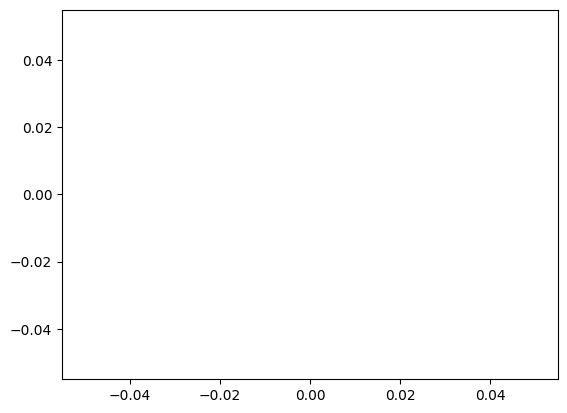

In [9]:
plt.plot(losses)
plt.show()

In [3]:
## resnet transfer learning

In [10]:
import torchvision
import torch.nn.functional as F

In [11]:
cifar_10 = torchvision.datasets.CIFAR10('../../resource/course_data', download=False, transform=preprocess)
train_loader = torch.utils.data.DataLoader(cifar_10,
                                          batch_size=512,
                                          shuffle=True)

In [12]:
plt.imshow(cifar_10[10][0].permute(1, 2, 0))

In [ ]:
for param in res_net.parameters():
    param.requires_grad = False

In [ ]:
# Parameters of newly constructed modules have requires_grad=True by default
num_ftrs = res_net.fc.in_features

res_net.fc = nn.Linear(num_ftrs, 10) # only update this part parameters 

criterion = nn.CrossEntropyLoss()

# Observe that only parameters of final layer are being optimized as
# opposed to before.
optimizer_conv = optim.SGD(res_net.fc.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochslosses = []

epochs = 10

In [ ]:
for epoch in range(epochs):
    loss_train = 0
    for i, (imgs, labels) in enumerate(train_loader):        
        print(i)
        outputs = res_net(imgs)
        
        loss = criterion(outputs, labels)
        
        optimizer_conv.zero_grad()
        
        loss.backward()
        
        optimizer_conv.step()
        
        loss_train += loss.item()
        
        if i > 0 and i % 10 == 0:
            print('Epoch: {}, batch: {}'.format(epoch, i))
            print('-- loss: {}'.format(loss_train / i))
            
    losses.append(loss_train / len(train_loader))

In [ ]:
## show resnet

In [19]:
import cv2
import numpy as np

import torch
from torchvision import transforms
from torchvision.models import resnet18
from torchsummary import summary
import matplotlib.pyplot as plt

In [20]:
def show_one_model(model, input_, output):
    width = 8

    fig, ax = plt.subplots(output[0].shape[0] // width, width, figsize=(20, 20))

    for i in range(output[0].shape[0]):
        ix = np.unravel_index(i, ax.shape)
        plt.sca(ax[ix])
        ax[ix].title.set_text('Filter-{}'.format(i))
        plt.imshow(output[0][i].detach())
        # plt.pause(0.05)

    input('this is conv: {}, received a {} tensor,  press any key to continue: '.format(model, input_[0].shape))

    plt.show()

In [21]:
def main(img):
    """
    前向传播，在传的过程中打印特征图
    """

    # 定义device、transforms
    transform = transforms.Compose([transforms.ToPILImage(),
                                    transforms.Resize((224, 224)),
                                    transforms.ToTensor(),
                                    ])
    # 处理图片、定义模型
    img = transform(img).unsqueeze(0)
    model = resnet18(pretrained=True)

    # 打印模型summary，可用于卷积层对照
    summary(model, (3, 224, 224))

    for p in model.parameters():
        print(p)

    conv_models = [m for _, m in model.named_modules() if isinstance(m, torch.nn.Conv2d)]

    for conv in conv_models:
        conv.register_forward_hook(show_one_model)

    with torch.no_grad():
        model(img)

    # conv_models = [m for _, m in model.named_modules() if isinstance(m, torch.nn.Conv2d)]
    #
    # first_conv = conv_models[0]
    #
    # show_one_model(first_conv, img, output=first_conv(img))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1, 64,

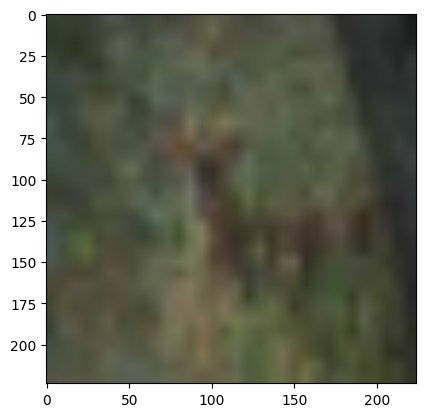

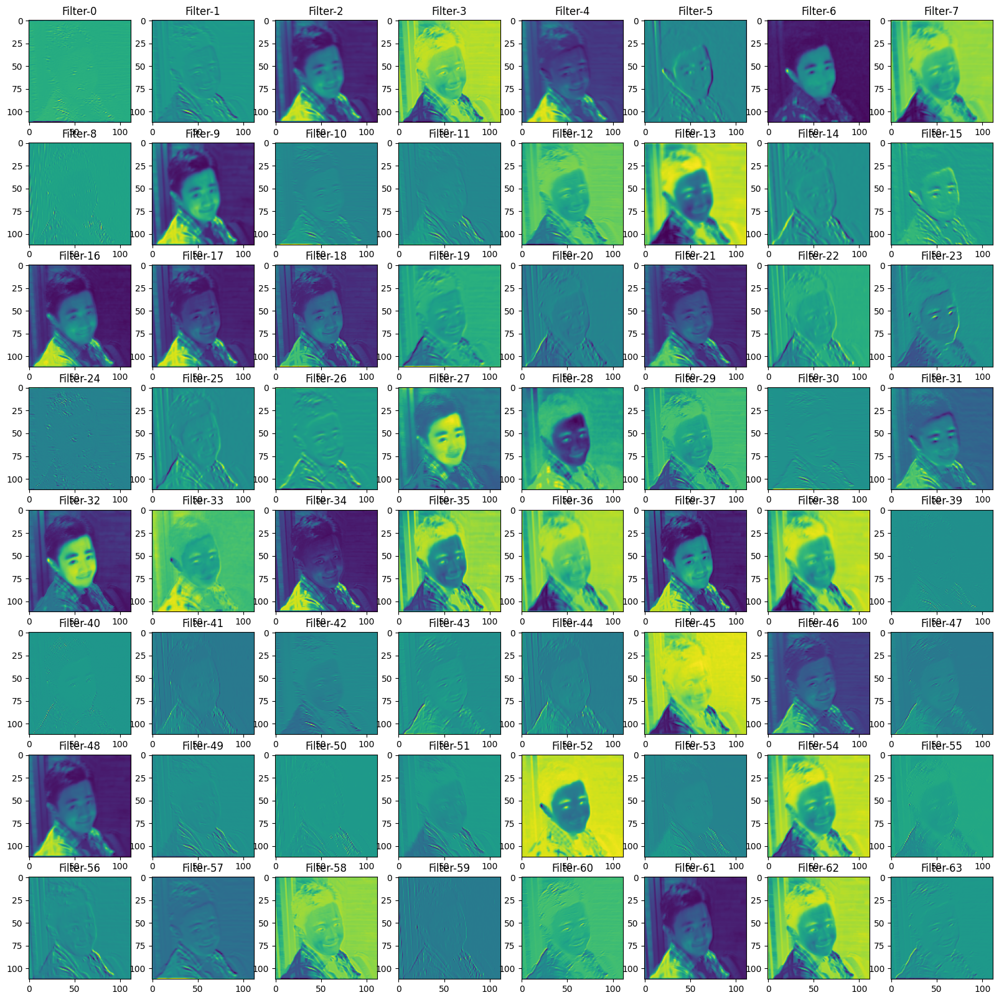

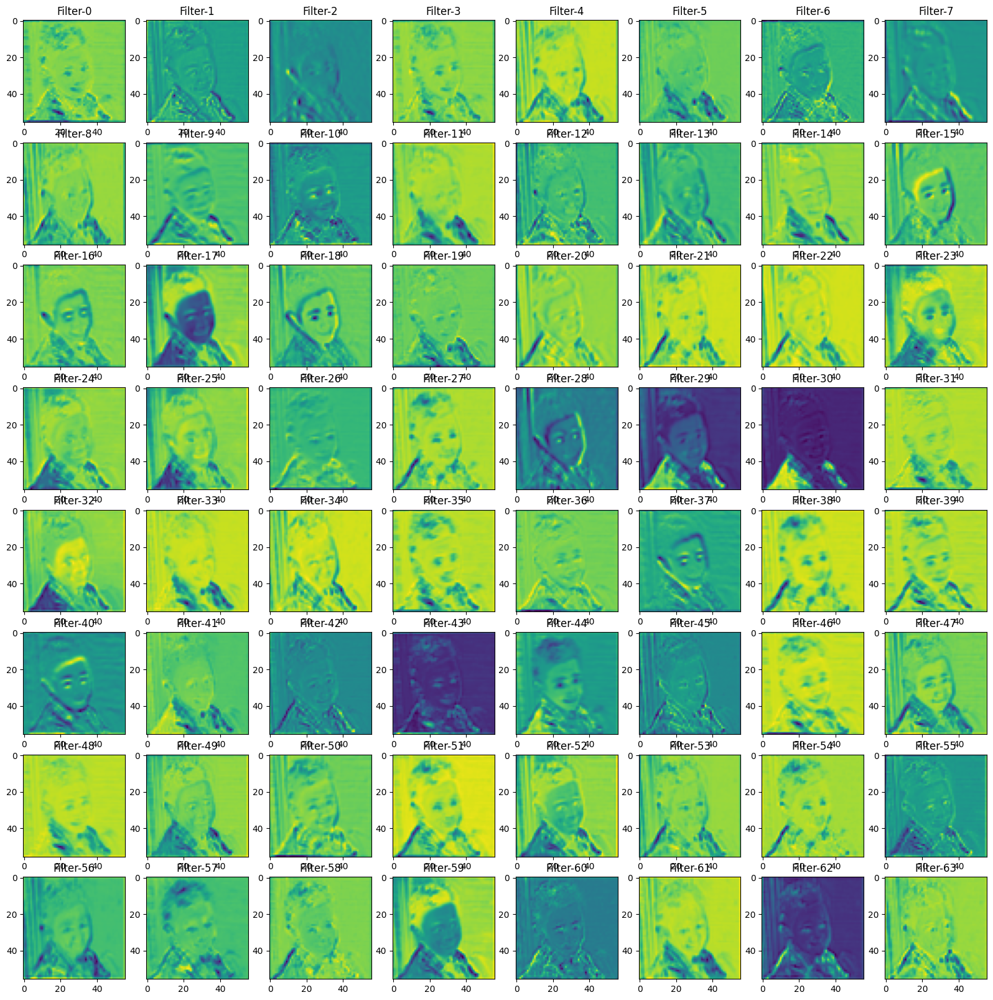

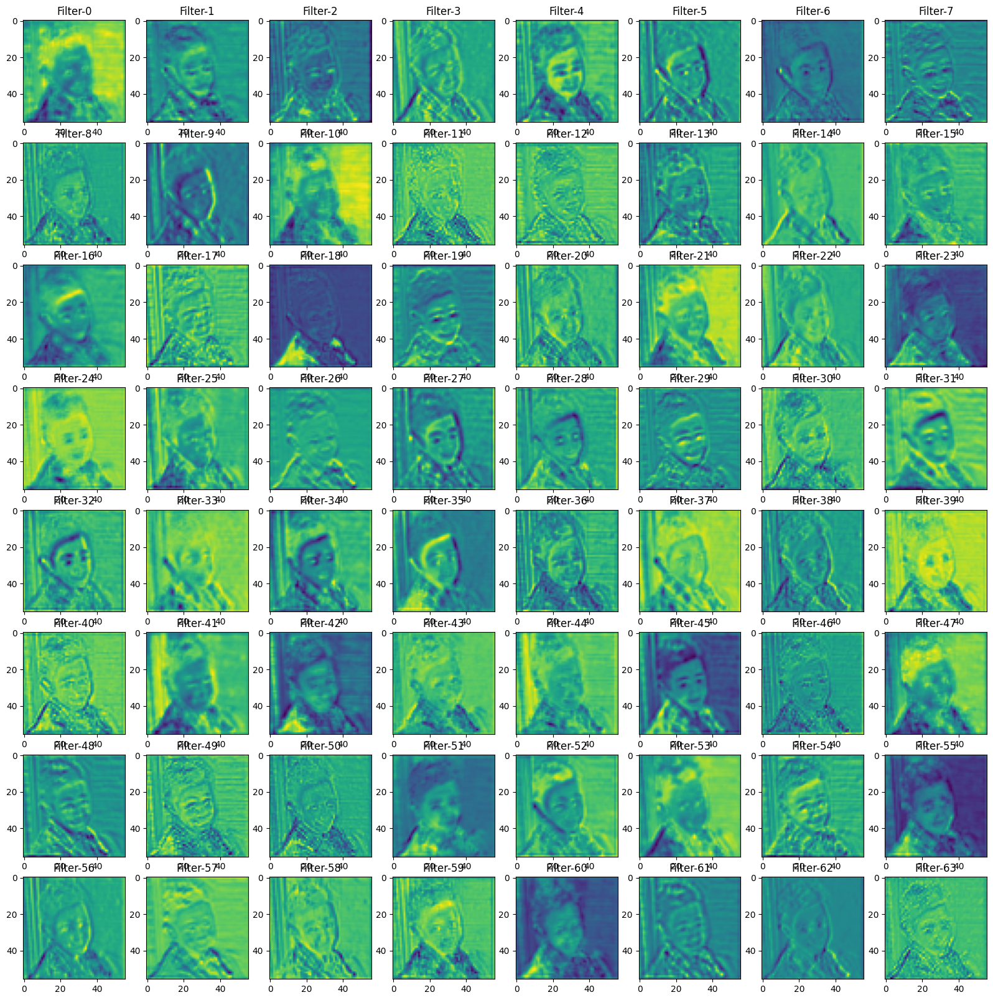

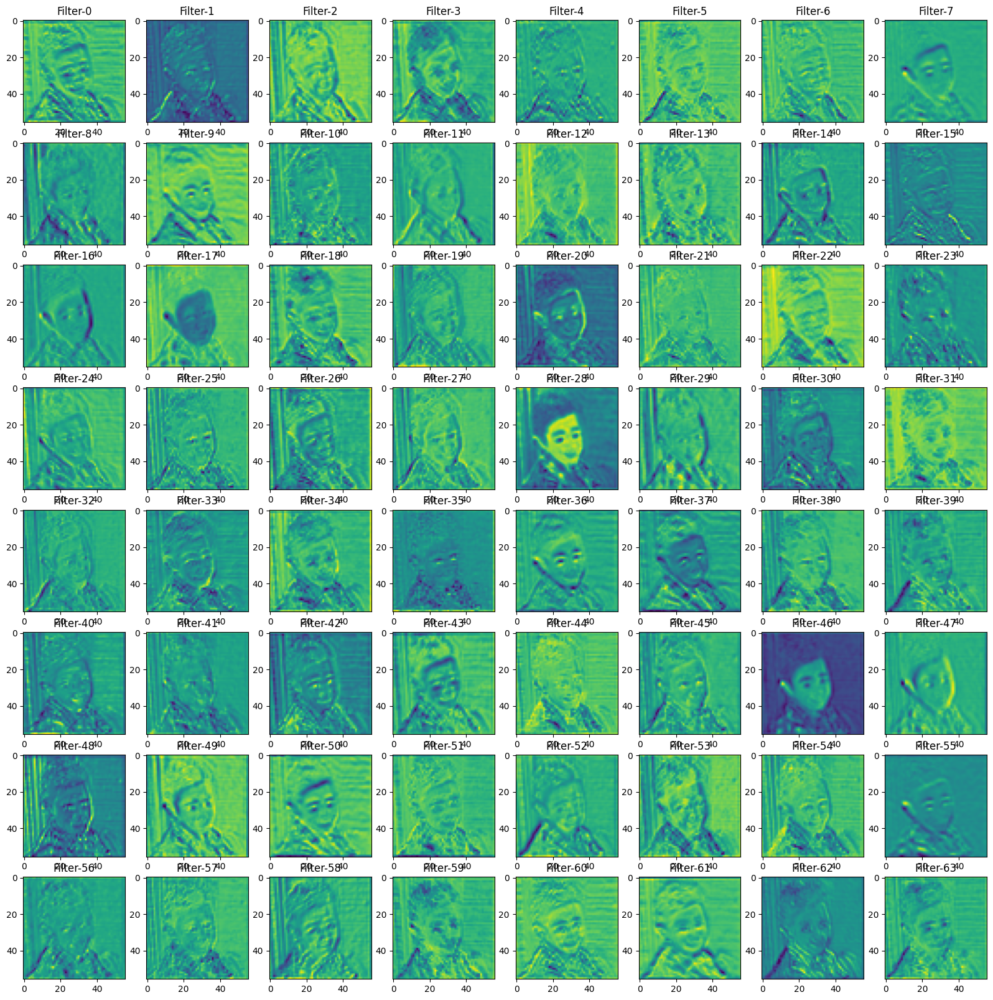

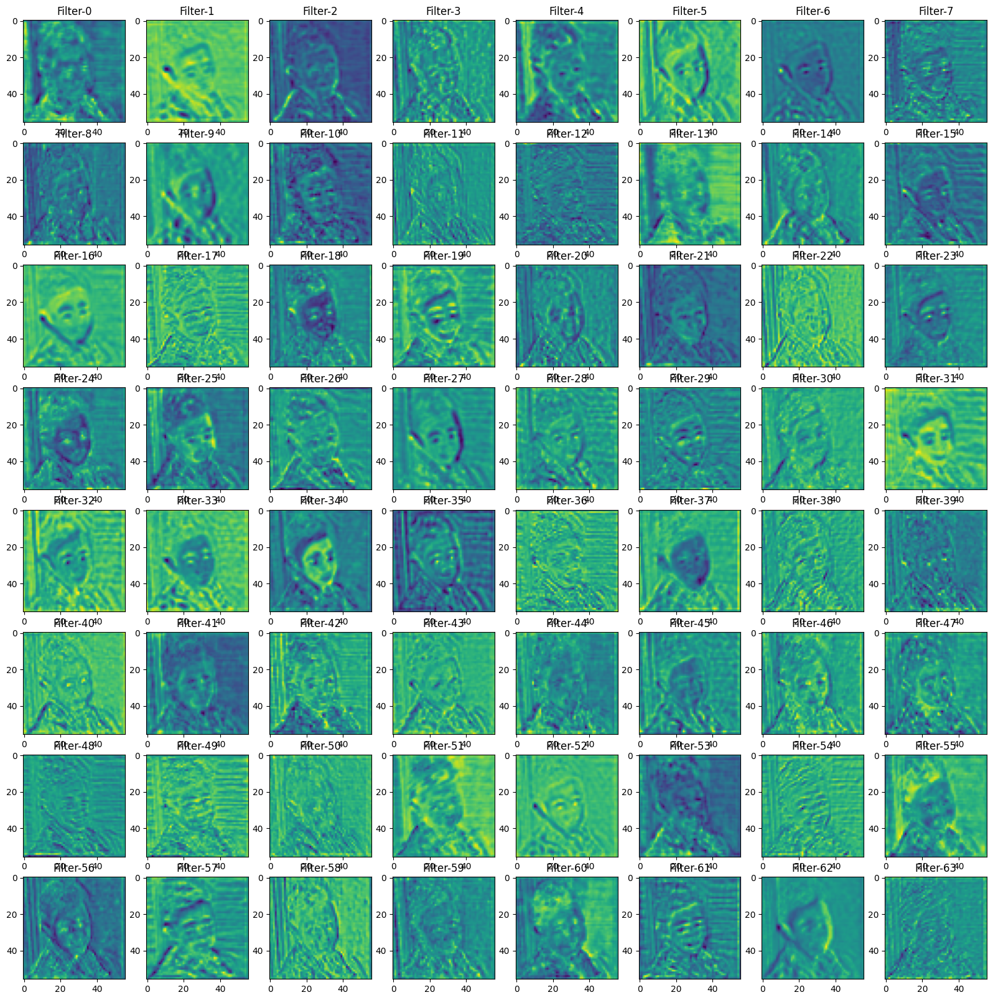

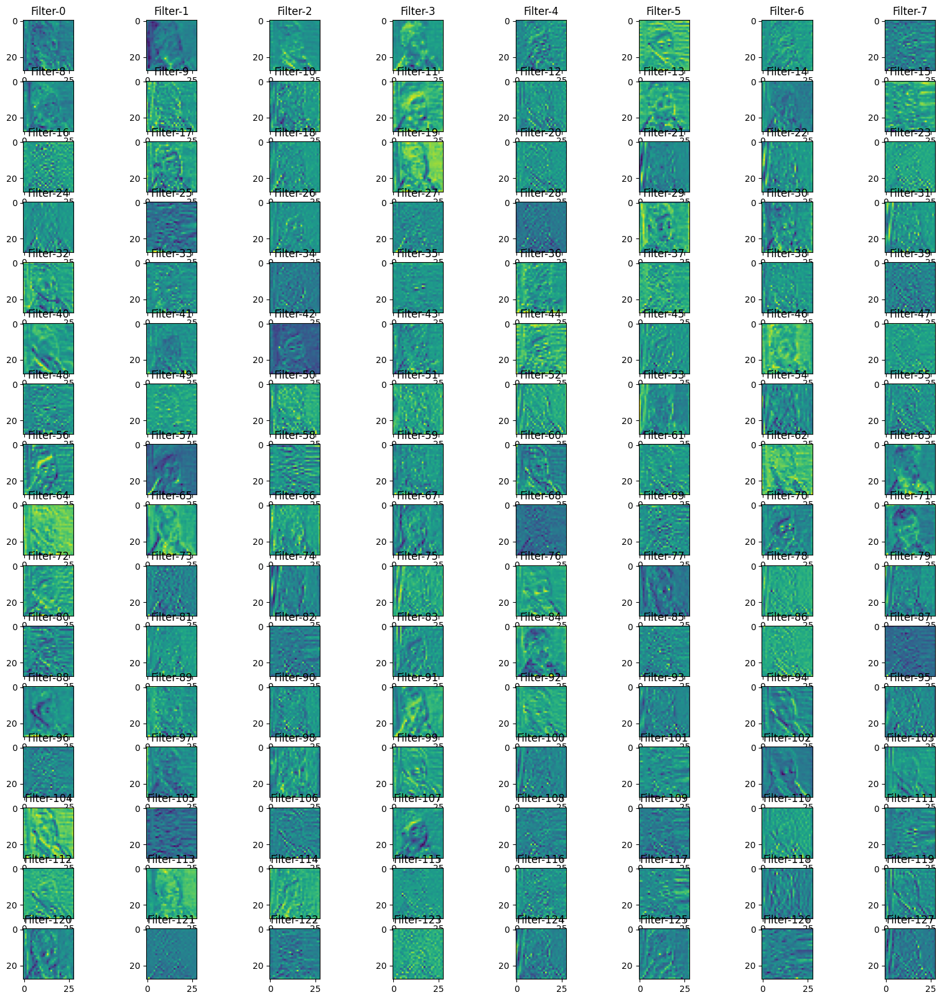

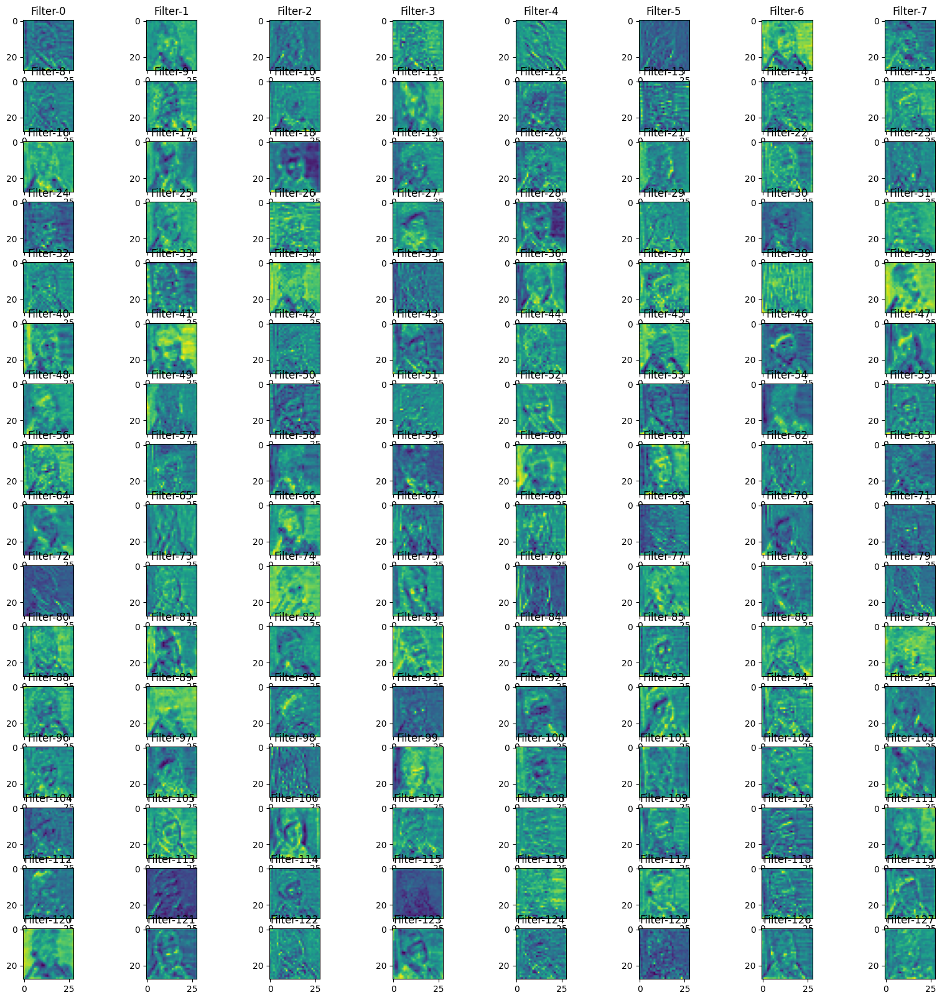

KeyboardInterrupt: 

In [23]:
if __name__ == '__main__':
    img = cv2.imread('../../resource/course_data/doo.png')
    main(img)